In [22]:
!pip install --upgrade mxnet
!pip install tifffile
!pip install pillow

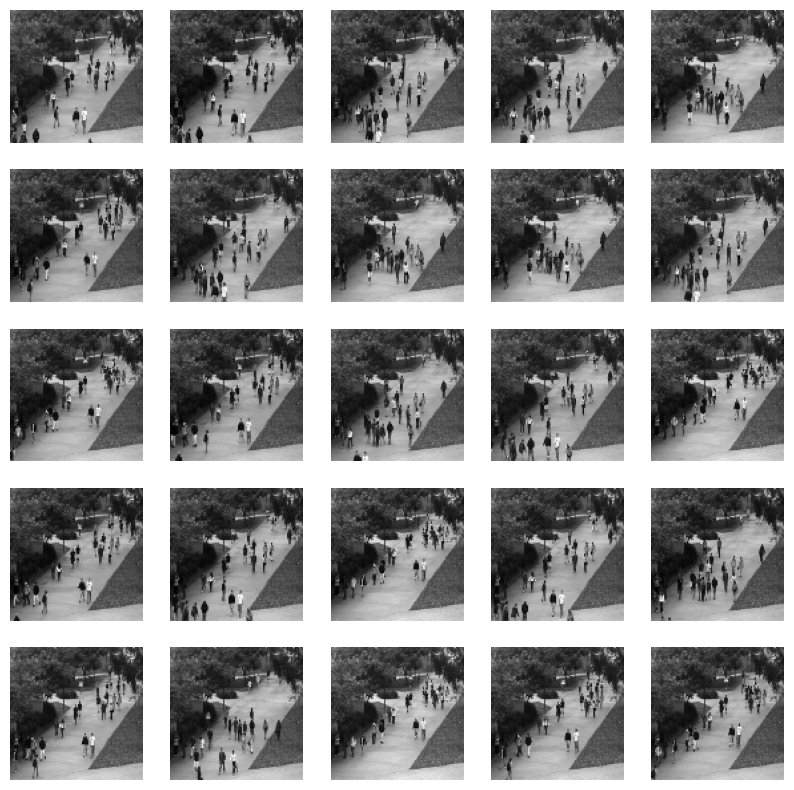

In [27]:
import tensorflow as tf
from PIL import Image
import numpy as np
import glob
import os
import matplotlib.pyplot as plt
import cv2

def load_and_preprocess_image_opencv(file_path):
    try:
        # Read the image in grayscale
        img = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
        if img is None:
            raise ValueError("Image not loaded; possible bad file")
        # Resize the image
        img = cv2.resize(img, (100, 100))
        # Normalize the image
        img_array = img.astype(np.float32) / 255.0
        # Expand the dimensions to add the channel
        img_array = np.expand_dims(img_array, axis=-1)
        return img_array, img_array
    except Exception as e:
        print(f"Error processing image {file_path}: {e}")
        # Return a zero-filled array to maintain consistency
        return np.zeros((100, 100, 1), dtype=np.float32), np.zeros((100, 100, 1), dtype=np.float32)
    
    
# Adjust the dataset creation to handle preprocessing directly
def create_dataset(root_dir, batch_size):
    file_paths = glob.glob(os.path.join(root_dir, 'Train', '*', '*.tif'))
    dataset = tf.data.Dataset.from_tensor_slices(file_paths)
    
    def _load_image(file_path):
        file_path = file_path.numpy().decode("utf-8")  # Decode from tensor to string
        image, _ = load_and_preprocess_image_opencv(file_path)
        return tf.convert_to_tensor(image, dtype=tf.float32), tf.convert_to_tensor(image, dtype=tf.float32)
    
    def load_image_wrapper(file_path):
        # Use tf.py_function to wrap _load_image function
        return tf.py_function(_load_image, [file_path], [tf.float32, tf.float32])
    
    dataset = dataset.map(load_image_wrapper, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.filter(lambda x, y: tf.reduce_sum(x) > 0)  # Optionally filter out all-zero images
    dataset = dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return dataset

# Note: Adjust `root_dir` to your correct directory path
batch_size = 32
root_dir = '/kaggle/input/ucsd-anomaly/UCSD_Anomaly_Dataset.v1p2/UCSDped1/'
train_dataset = create_dataset(root_dir, batch_size)



def show_batch(image_batch):
    plt.figure(figsize=(10, 10))
    for n in range(min(len(image_batch), 25)):  # Show a maximum of 25 images
        ax = plt.subplot(5, 5, n + 1)
        plt.imshow(image_batch[n].squeeze(), cmap='gray')  # Assuming grayscale images
        plt.axis('off')
    plt.show()

# Debugging: Show first batch
for images, _ in train_dataset.take(1):
    # Your existing code to visualize the batch
    show_batch(images.numpy())


In [40]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization, Activation, Add, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.optimizers import Adam

def build_revised_autoencoder(input_shape):
    input_img = Input(shape=input_shape)

    # Encoder
    x = Conv2D(32, (3, 3), padding='same')(input_img)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)

    x = Conv2D(32, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = Conv2D(32, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = UpSampling2D((2, 2))(x)

    x = Conv2D(32, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = UpSampling2D((2, 2))(x)

    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)  # Ensure the final layer uses sigmoid for [0, 1] range

    # Autoencoder Model
    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    return autoencoder

# Define input shape
input_shape = (100, 100, 1)  # Modify as needed

# Build and compile the revised autoencoder
autoencoder = build_revised_autoencoder(input_shape)

# Assuming you have defined `train_dataset` and `val_dataset`
# Train the model with callbacks for early stopping and model checkpointing
history = autoencoder.fit(
    train_dataset,
    epochs=5,  
    callbacks=callbacks
)


Epoch 1/5
213/213 [==============================] - 16s 64ms/step - loss: 0.0093
Epoch 2/5
213/213 [==============================] - 12s 58ms/step - loss: 0.0034
Epoch 3/5
213/213 [==============================] - 13s 60ms/step - loss: 0.0027
Epoch 4/5
213/213 [==============================] - 13s 59ms/step - loss: 0.0025
Epoch 5/5
213/213 [==============================] - 13s 59ms/step - loss: 0.0023


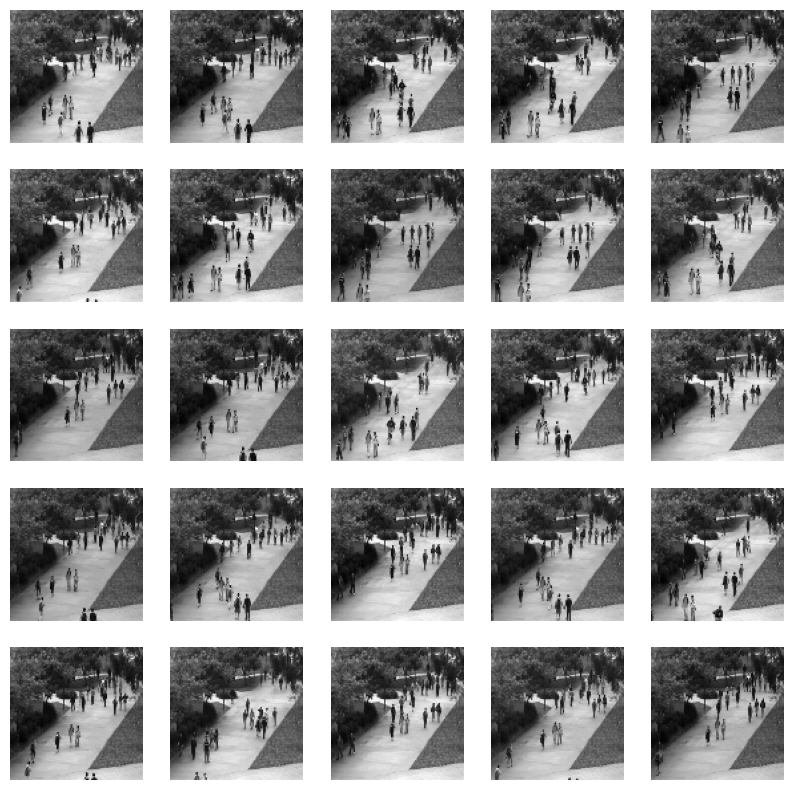

In [41]:
#test dataset load
def create_dataset_test(root_dir, batch_size):
    file_paths = glob.glob(os.path.join(root_dir, 'Test', '*', '*.tif'))
    dataset = tf.data.Dataset.from_tensor_slices(file_paths)
    
    def _load_image(file_path):
        file_path = file_path.numpy().decode("utf-8")  # Decode from tensor to string
        image, _ = load_and_preprocess_image_opencv(file_path)
        return tf.convert_to_tensor(image, dtype=tf.float32), tf.convert_to_tensor(image, dtype=tf.float32)
    
    def load_image_wrapper(file_path):
        # Use tf.py_function to wrap _load_image function
        return tf.py_function(_load_image, [file_path], [tf.float32, tf.float32])
    
    dataset = dataset.map(load_image_wrapper, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.filter(lambda x, y: tf.reduce_sum(x) > 0)  # Optionally filter out all-zero images
    dataset = dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return dataset

# Note: Adjust `root_dir` to your correct directory path
batch_size = 32
root_dir = '/kaggle/input/ucsd-anomaly/UCSD_Anomaly_Dataset.v1p2/UCSDped1/'
test_dataset = create_dataset_test(root_dir, batch_size)

for images, _ in test_dataset.take(1):
    # Your existing code to visualize the batch
    show_batch(images.numpy())

1/1 [==============================] - 0s 87ms/step


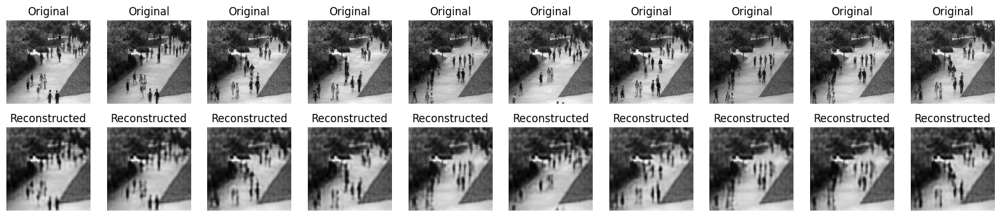

In [42]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_reconstruction(test_dataset, autoencoder, num_images=10):
    plt.figure(figsize=(20, 4))
    for images, _ in test_dataset.take(1):
        predictions = autoencoder.predict(images)
        for i in range(num_images):
            # Display original images
            ax = plt.subplot(2, num_images, i + 1)
            plt.imshow(images[i].numpy().squeeze(), cmap='gray')
            plt.title("Original")
            plt.axis('off')

            # Display reconstructed images
            ax = plt.subplot(2, num_images, i + 1 + num_images)
            plt.imshow(predictions[i].squeeze(), cmap='gray')
            plt.title("Reconstructed")
            plt.axis('off')
    plt.show()

visualize_reconstruction(test_dataset, autoencoder)


In [43]:
reconstruction_errors = []
for images, _ in test_dataset:
    predictions = autoencoder.predict(images)
    reconstruction_errors.append(np.mean(np.abs(images.numpy() - predictions), axis=(1, 2, 3)))

mean_error = np.mean(reconstruction_errors)
std_error = np.std(reconstruction_errors)

# Set a threshold as mean + 2*std of reconstruction errors
threshold = mean_error + 2*std_error
print("Threshold for anomaly detection:", threshold)


1/1 [==============================] - 0s 17ms/step
Threshold for anomaly detection: 0.041139353066682816


1/1 [==============================] - 0s 19ms/step


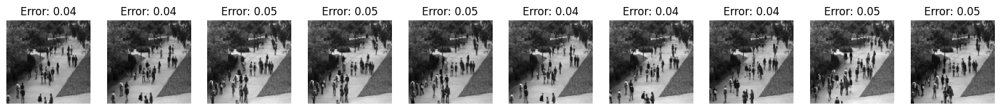

In [44]:
def visualize_anomalies(dataset, autoencoder, threshold):
    plt.figure(figsize=(20, 4))
    num_anomalies = 0
    for images, _ in dataset:
        predictions = autoencoder.predict(images)
        errors = np.mean(np.abs(images.numpy() - predictions), axis=(1, 2, 3))
        
        for i, error in enumerate(errors):
            if error > threshold:
                if num_anomalies >= 10:  # Display only the first 10 anomalies
                    return
                num_anomalies += 1
                
                # Display anomalous images
                ax = plt.subplot(2, 10, num_anomalies)
                plt.imshow(images[i].numpy().squeeze(), cmap='gray')
                plt.title(f"Error: {error:.2f}")
                plt.axis('off')

visualize_anomalies(test_dataset, autoencoder, threshold)


1/1 [==============================] - 0s 18ms/step


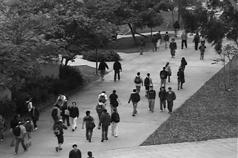

In [9]:
import tensorflow as tf
import numpy as np
import cv2
import os
import IPython.display as display
from PIL import Image
import io

# Function to preprocess the images
def preprocess_image(frame):
    # Resize and normalize the image
    frame = cv2.resize(frame, (100, 100))
    frame = frame / 255.0
    frame = np.expand_dims(frame, axis=-1)  # Add channel dimension if needed
    return frame

# Function to display a frame
def display_frame(frame, format='jpeg'):
    f = io.BytesIO()
    img = Image.fromarray(frame)
    img.save(f, format)
    display.display(display.Image(data=f.getvalue()))

# Load your trained autoencoder model
#autoencoder = tf.keras.models.load_model('/path/to/your_model.h5')

# Set a threshold for anomaly detection
threshold = 0.01  # Adjust based on your model and validation set

# Directory containing the video frames
frame_dir = '/kaggle/input/ucsd-anomaly/UCSD_Anomaly_Dataset.v1p2/UCSDped1/Test/Test003'

# Process and display each frame
for frame_name in sorted(os.listdir(frame_dir)):
    if frame_name.endswith('.tif'):
        frame_path = os.path.join(frame_dir, frame_name)
        frame = cv2.imread(frame_path, cv2.IMREAD_GRAYSCALE)
        preprocessed_frame = preprocess_image(frame)

        # Model prediction
        reconstructed_frame = autoencoder.predict(np.expand_dims(preprocessed_frame, axis=0))[0]

        # Calculate error
        mse = np.mean(np.power(preprocessed_frame - reconstructed_frame, 2))
        
        # Mark frame as an anomaly with a red circle if mse exceeds threshold
        if mse > threshold:
            frame = cv2.cvtColor(frame, cv2.COLOR_GRAY2BGR)  # Convert grayscale to BGR color space
            center_coords = (frame.shape[1] // 2, frame.shape[0] // 2)
            cv2.circle(frame, center_coords, 20, (0, 0, 255), 2)  # Draw red circle

        # Display the frame with potential anomaly highlighted
        display_frame(frame)
        display.clear_output(wait=True)  # Clear the output to display the next frame


1/1 [==============================] - 0s 38ms/step


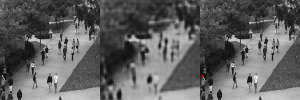

1/1 [==============================] - 0s 21ms/step


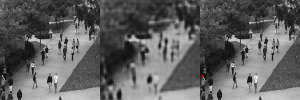

1/1 [==============================] - 0s 21ms/step


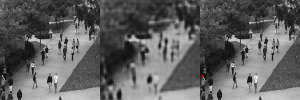

1/1 [==============================] - 0s 19ms/step


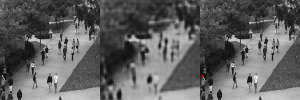

1/1 [==============================] - 0s 18ms/step


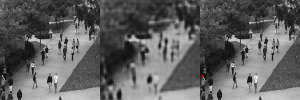

In [46]:
import numpy as np
import tensorflow as tf
from IPython.display import Image, display
import imageio
from io import BytesIO

# Set your anomaly detection threshold
anomaly_threshold = 0.4

def create_and_display_anomaly_gif(autoencoder, test_dataset, anomaly_threshold):
    images_for_gif = []  # List to hold the images for the GIF
    for batch in test_dataset.take(5):  # Take just the first batch from the dataset
        test_images = batch[0].numpy()  # Get the images from the batch
        reconstructed_images = autoencoder.predict(test_images)  # Get the reconstructed images from the autoencoder
        
        # Calculate the reconstruction error
        reconstruction_errors = np.abs(test_images - reconstructed_images)
        
        for i in range(test_images.shape[0]):
            # Find anomalies (where the error is above the threshold)
            anomalies = reconstruction_errors[i] > anomaly_threshold
            anomalies = anomalies.squeeze()  # Ensure anomalies is 2D
            
            # Create an RGB image for the anomalies
            anomaly_image = np.zeros((test_images[i].shape[0], test_images[i].shape[1], 3), dtype=np.uint8)
            anomaly_image[anomalies, :] = [255, 0, 0]  # Red channel for anomalies
            
            # Ensure all images have three channels
            original_rgb = np.squeeze(np.stack((test_images[i],) * 3, axis=-1))
            reconstructed_rgb = np.squeeze(np.stack((reconstructed_images[i],) * 3, axis=-1))
            
            # Normalize and convert images to uint8
            original_uint8 = (original_rgb * 255).astype(np.uint8)
            reconstructed_uint8 = (reconstructed_rgb * 255).astype(np.uint8)
            
            # Overlay anomalies on the original image
            original_with_anomalies = original_uint8.copy()
            original_with_anomalies[anomalies, :] = [255, 0, 0]
            
            # Combine the original, reconstructed, and anomaly images
            combined_image = np.hstack((original_uint8, reconstructed_uint8, original_with_anomalies))
            
            # Append to the list of images for GIF
            images_for_gif.append(combined_image)
        
        # Convert the list of images to a byte buffer for display in the notebook
        gif_bytes = BytesIO()
        imageio.mimsave(gif_bytes, images_for_gif, fps=2, format='gif')
        display(Image(data=gif_bytes.getvalue(), format='gif'))

# Call the function with your model, test dataset, and chosen threshold
create_and_display_anomaly_gif(autoencoder, train_dataset, anomaly_threshold)


1/1 [==============================] - 0s 18ms/step


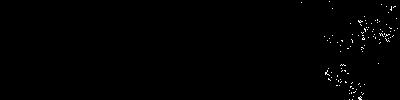

In [11]:
import numpy as np
import tensorflow as tf
from IPython.display import Image, display
import imageio
from io import BytesIO

# Define the function to create and display the GIF
def create_and_display_anomaly_gif(model, dataset, threshold):
    # Initialize the buffer for the GIF
    gif_buffer = BytesIO()

    # Process the dataset
    for batch in dataset.take(1):  # Taking only the first batch
        input_batch = batch[0]  # Assuming the first element is the input

        # Predict the reconstructed images
        reconstructed_images = model.predict(input_batch)

        # Calculate the reconstruction errors
        errors = np.abs(input_batch - reconstructed_images)

        # Determine the threshold for anomalies
        anomalies = errors > threshold
        
        # Prepare the images for the GIF
        frames = []
        for i in range(input_batch.shape[0]):
            # Get the individual frames
            original_frame = input_batch[i].numpy().squeeze()
            reconstructed_frame = reconstructed_images[i].squeeze()
            error_frame = errors[i].squeeze()

            # Identify the anomalies and mark them in red
            anomalies_current_frame = anomalies[i].squeeze()
            anomaly_frame = np.zeros_like(original_frame)
            anomaly_frame[anomalies_current_frame] = 255  # Mark anomalies in red

            # Stack the frames horizontally
            combined_frame = np.hstack((original_frame, reconstructed_frame, error_frame, anomaly_frame))
            frames.append(combined_frame)

        # Save the frames as a GIF
        imageio.mimsave(gif_buffer, np.array(frames).astype(np.uint8), format='GIF', fps=5)

    # Display the GIF
    display(Image(data=gif_buffer.getvalue(), format='gif', embed=True))

# Now call the function with your autoencoder model and the test dataset
create_and_display_anomaly_gif(autoencoder, test_dataset, threshold=0.1)
